In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')

Dataset link: https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package

In [2]:
df = pd.read_csv('weatherAUS.csv')
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [3]:
df.shape

(145460, 23)

In [4]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

# <b><b>Handling DateTime 

In [5]:
# converting Date column from object to datetime and extract year,month,day,quarter
df['Date'] = pd.to_datetime(df['Date'])
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month_name()
df['Day'] = df['Date'].dt.day_name()
df['Quarter'] = df['Date'].dt.quarter

df.drop(columns='Date',inplace=True)

# <b><b>EDA

In [6]:
#Extract categorical columns from dataset
categorical_columns = [col for col in df.columns if df[col].dtypes=='O']
categorical_columns

['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow',
 'Month',
 'Day']

## Univariate Analysis

In [7]:
#Show the Name of Location with their frequency
print(df['Location'].value_counts())

#Plot the Location Name.
fig = px.histogram(df, x='Location', color='Location',title='Rain in Different Locations.')
fig.update_layout(xaxis=dict(tickangle=270),title_font=dict(size=30))
fig.show()

Location
Canberra            3436
Sydney              3344
Adelaide            3193
Darwin              3193
Hobart              3193
Perth               3193
Melbourne           3193
Brisbane            3193
Albury              3040
MountGinini         3040
GoldCoast           3040
Wollongong          3040
MountGambier        3040
Launceston          3040
AliceSprings        3040
Albany              3040
Townsville          3040
Bendigo             3040
Cairns              3040
Ballarat            3040
Penrith             3039
Newcastle           3039
Tuggeranong         3039
PerthAirport        3009
Williamtown         3009
Cobar               3009
BadgerysCreek       3009
SydneyAirport       3009
Richmond            3009
Moree               3009
CoffsHarbour        3009
NorfolkIsland       3009
WaggaWagga          3009
Witchcliffe         3009
Watsonia            3009
Dartmoor            3009
Portland            3009
Sale                3009
MelbourneAirport    3009
Mildura         

In [8]:
#Show the Wind Direction with their frequency.
print(df['WindGustDir'].value_counts())

#Plot the Wind Direction.
fig = px.histogram(df, x='WindGustDir', color='WindGustDir',title='Rain in Different Wind Gust Direction.')
fig.update_layout(title_font=dict(size=30))
fig.show()

WindGustDir
W      9915
SE     9418
N      9313
SSE    9216
E      9181
S      9168
WSW    9069
SW     8967
SSW    8736
WNW    8252
NW     8122
ENE    8104
ESE    7372
NE     7133
NNW    6620
NNE    6548
Name: count, dtype: int64


In [9]:
#Show the Wind Direction at 9am with their frequency.
print(df['WindDir9am'].value_counts())

#Plot the Wind Direction at 9am.
fig = px.histogram(df, x='WindDir9am', color='WindDir9am',title='Rain in Different Wind Direction at 9am.')
fig.update_layout(title_font=dict(size=30))
fig.show()

WindDir9am
N      11758
SE      9287
E       9176
SSE     9112
NW      8749
S       8659
W       8459
SW      8423
NNE     8129
NNW     7980
ENE     7836
NE      7671
ESE     7630
SSW     7587
WNW     7414
WSW     7024
Name: count, dtype: int64


In [10]:
#Show the Wind Direction at 3pm with their frequency.
print(df['WindDir3pm'].value_counts())

#Plot the Wind Direction at 3pm.
fig = px.histogram(df, x='WindDir3pm', color='WindDir3pm',title='Rain in Different Wind Direction at 3pm.')
fig.update_layout(title_font=dict(size=30))
fig.show()

WindDir3pm
SE     10838
W      10110
S       9926
WSW     9518
SSE     9399
SW      9354
N       8890
WNW     8874
NW      8610
ESE     8505
E       8472
NE      8263
SSW     8156
NNW     7870
ENE     7857
NNE     6590
Name: count, dtype: int64


In [11]:
#Show the Possibility of RainToday with their frequency.
print(df['RainToday'].value_counts())

#Plot the Possibility of RainToday.
fig = px.histogram(df, x='RainToday', color='RainToday',title='Rain Possibility on Today.')
fig.update_layout(title_font=dict(size=30))
fig.show()

RainToday
No     110319
Yes     31880
Name: count, dtype: int64


In [12]:
#Show the Possibility of RainTomorrow with their frequency.
print(df['RainTomorrow'].value_counts())

#Plot the Possibility of RainTomorrow.
fig = px.histogram(df, x='RainTomorrow', color='RainTomorrow',title='Rain Probability of Tomorrow.')
fig.update_layout(title_font=dict(size=30))
fig.show()

RainTomorrow
No     110316
Yes     31877
Name: count, dtype: int64


## Bivariarte Analysis

In [13]:
#Plot the Yearly Rainfall
rainfall_per_year = df.groupby('Year')['Rainfall'].sum().reset_index()
fig = px.bar(rainfall_per_year, y='Rainfall',x='Year',title='Yearly Rainfall.',color='Rainfall', pattern_shape_sequence= "x")

fig.update_layout(width=1000,height=500,yaxis_title='Rainfall (mm)',yaxis_tickformat=',',yaxis_ticksuffix='mm ',
                    xaxis=dict(tickmode='linear',tick0=rainfall_per_year['Year'].min(),dtick=1) ,
                    xaxis_title_font=dict(size=18),yaxis_title_font=dict(size=18),title_font=dict(size=30))

fig.update_coloraxes(colorbar=dict(tickvals=[10000, 20000, 30000, 40000],ticktext=["10000 mm", "20000 mm", "30000 mm", "40000 mm"],ticksuffix=" mm"))
fig.show()

In [14]:
#Plot the Monthly Rainfall
rainfall_per_month = df.groupby('Month')['Rainfall'].sum().reset_index().sort_values(by='Rainfall',ascending=False)
fig = px.bar(rainfall_per_month, y='Rainfall',x='Month',title='Monthly Rainfall Highest to lowest.',
             color='Rainfall', pattern_shape_sequence= "x")

fig.update_layout(width=1000,height=500,yaxis_title='Rainfall (mm)',yaxis_tickformat=',',yaxis_ticksuffix='mm ',
                    xaxis_title_font=dict(size=18),yaxis_title_font=dict(size=18),title_font=dict(size=30))

fig.update_coloraxes(colorbar=dict(tickvals=[20000, 25000, 30000, 35000],
                                   ticktext=["20000 mm", "25000 mm", "30000 mm", "35000 mm"],
                                   ticksuffix=" mm"))
fig.show()

In [15]:
#Plot the Daily Rainfall
rainfall_per_day = df.groupby('Day')['Rainfall'].sum().reset_index().sort_values(by='Rainfall',ascending=False)
fig = px.bar(rainfall_per_day, y='Rainfall',x='Day',title='Daily Rainfall Highest to lowest.',color='Rainfall', pattern_shape_sequence= "x")

fig.update_layout(width=1000,height=500,yaxis_title='Rainfall (mm)',yaxis_tickformat=',',yaxis_ticksuffix='mm ',
                    xaxis_title_font=dict(size=18),yaxis_title_font=dict(size=18),title_font=dict(size=30))

fig.update_coloraxes(colorbar=dict(tickvals=[47000, 47500, 48000, 48500,49000],ticktext=["47000 mm", "47500 mm", "48000 mm", "48500 mm","49000 mm"],ticksuffix=" mm"))
fig.show()

In [16]:
#Plot the Yearly Rainfall in different Location.
fig = px.line(df, x='Year', y='Rainfall', title='Yearly Rainfall in Location',
              markers=True,color='Location')
fig.update_layout(width=1000,height=500,yaxis_title='Rainfall (mm)',
                  xaxis=dict(tickmode='linear',tick0=df['Year'].min(),dtick=1))
fig.show()

# <b><b>Feature Engineering

In [17]:
#Extract the Numerical Columns from the Dataset.
numerical_columns = [col for col in df.columns if df[col].dtypes!='O']
numerical_columns

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'Year',
 'Quarter']

In [18]:
#Descriptive Statistics of Numerical Columns
df[numerical_columns].describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Quarter
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000,145460.000000,145460.000000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339,2012.769751,2.466678
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665,2.537684,1.114153
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000,2007.000000,1.000000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000,2011.000000,1.000000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000,2013.000000,2.000000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000,2015.000000,3.000000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000,2017.000000,4.000000


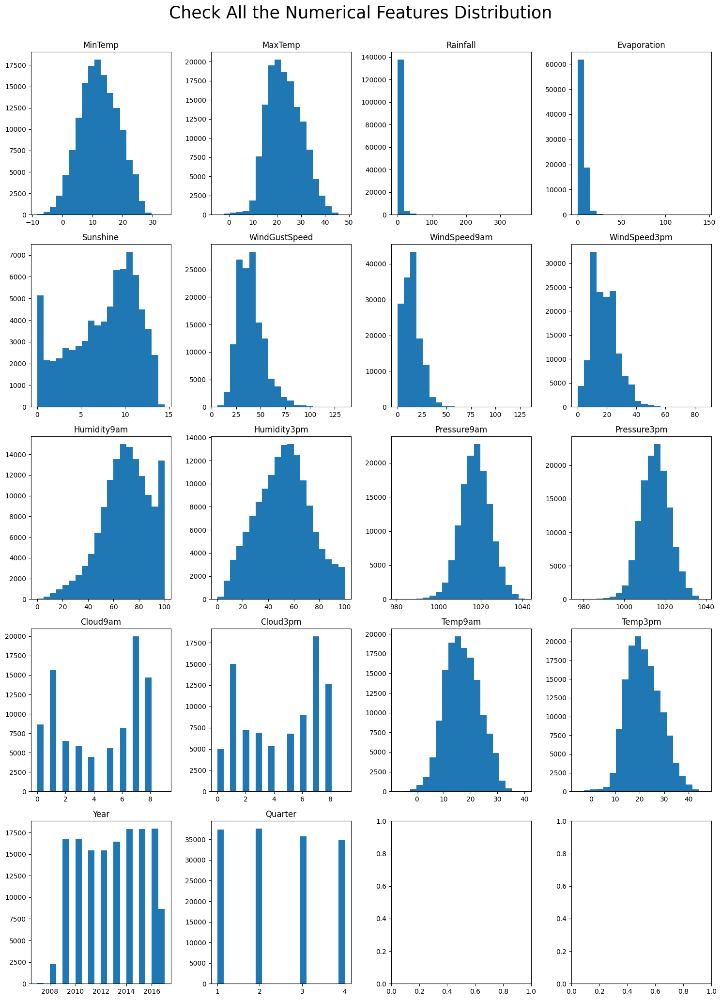

In [19]:
#Plot the Numerical Features Distribution.
col = df[numerical_columns].columns

fig,axes = plt.subplots(5,4,figsize=(15,20))
axes= axes.flatten()

for i,s in enumerate(col):
    axes[i].hist(df[s],bins=20)
    axes[i].set_title(s)

plt.tight_layout()
fig.suptitle('Check All the Numerical Features Distribution',fontsize=25,y=1.03)
plt.show()

<b><b>Observation: All features are not normally distributed except Rainfall and Evaporation.

In [20]:
#Trnsform the Numerical Features distribution into Normal Distribution.
#Mention that after transformation you won't have to scale the data again.
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer(method='yeo-johnson')
df[numerical_columns] = pt.fit_transform(df[numerical_columns])

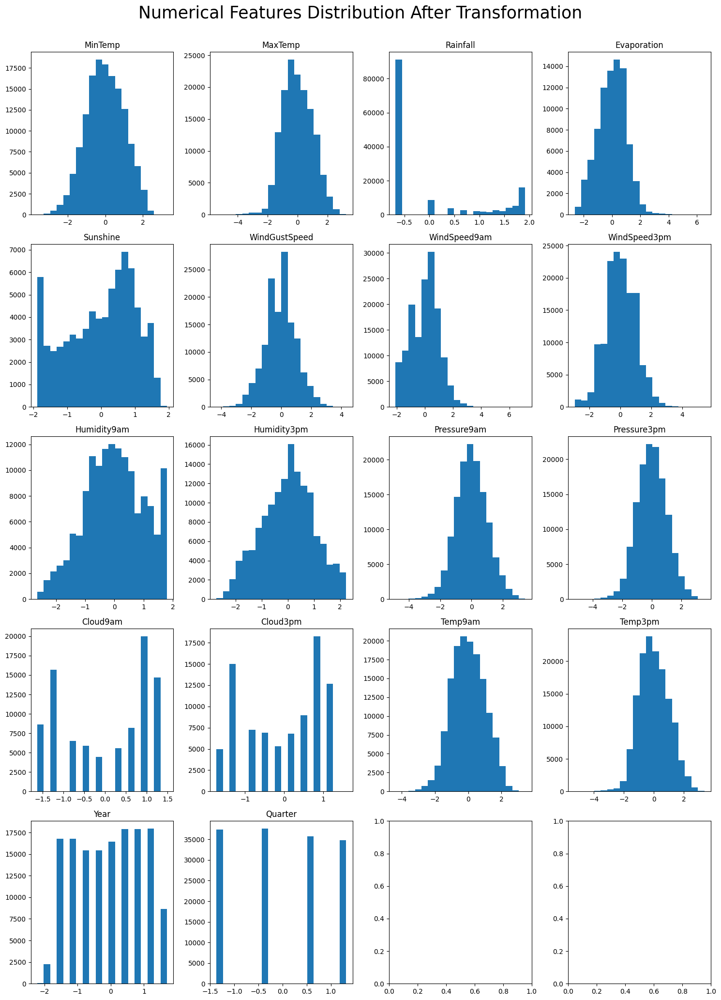

In [21]:
col = df[numerical_columns].columns

fig,axes = plt.subplots(5,4,figsize=(15,20))
axes= axes.flatten()

for i,s in enumerate(col):
    axes[i].hist(df[s],bins=20)
    axes[i].set_title(s)

plt.tight_layout()
fig.suptitle('Numerical Features Distribution After Transformation',fontsize=25,y=1.03)
plt.show()

In [22]:
#Impute the Missing Values.
df.interpolate(method='polynomial',order=3,inplace=True)

In [23]:
df.isnull().sum()

Location             0
MinTemp              0
MaxTemp              1
Rainfall             0
Evaporation       7628
Sunshine          9206
WindGustDir      10326
WindGustSpeed        1
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am         0
WindSpeed3pm         0
Humidity9am          0
Humidity3pm          0
Pressure9am          0
Pressure3pm          0
Cloud9am             0
Cloud3pm             2
Temp9am              0
Temp3pm              0
RainToday         3261
RainTomorrow      3267
Year                 0
Month                0
Day                  0
Quarter              0
dtype: int64

In [24]:
df.dropna(inplace=True)

In [25]:
#Create a Function to Detect Outliers.
def detect_outliers_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return (df < lower_bound) | (df > upper_bound)

In [26]:
outliers = detect_outliers_iqr(df[numerical_columns])
outliers.sum()

MinTemp            200
MaxTemp            524
Rainfall             0
Evaporation      39458
Sunshine         39399
WindGustSpeed      991
WindSpeed9am       871
WindSpeed3pm       820
Humidity9am        262
Humidity3pm        367
Pressure9am       9262
Pressure3pm       9191
Cloud9am         31426
Cloud3pm         32024
Temp9am            423
Temp3pm            644
Year                 0
Quarter              0
dtype: int64

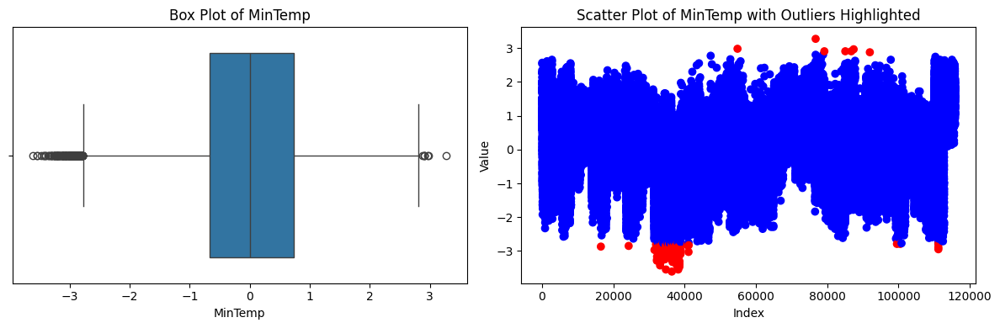

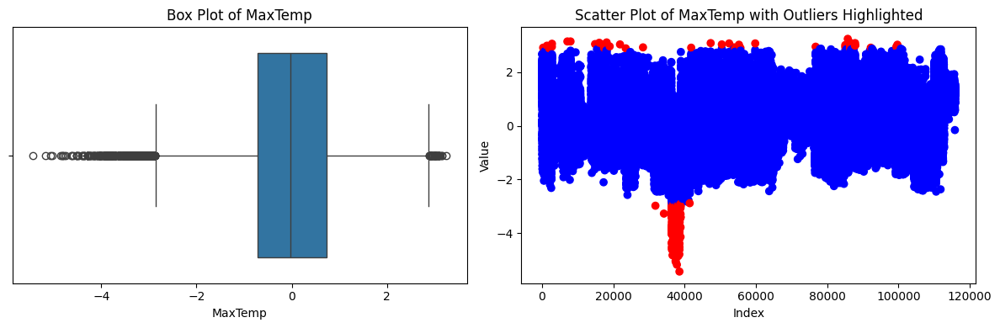

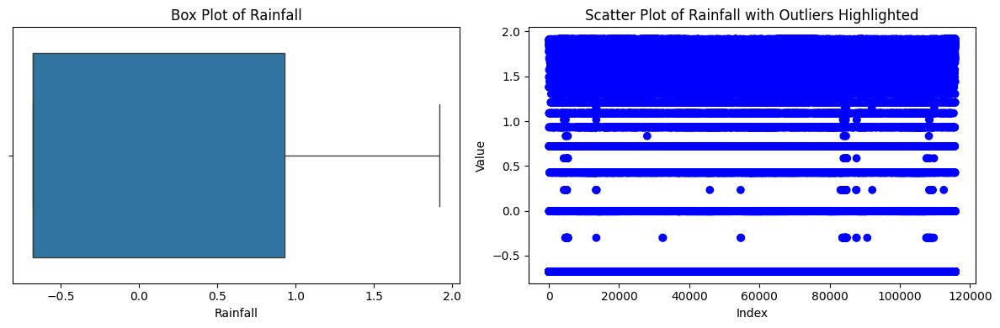

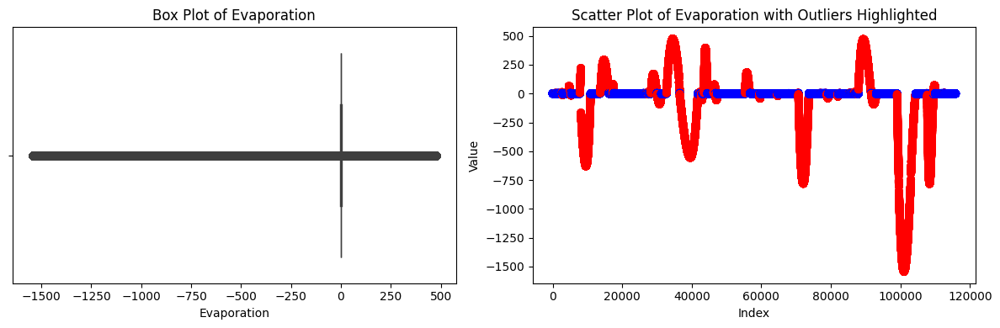

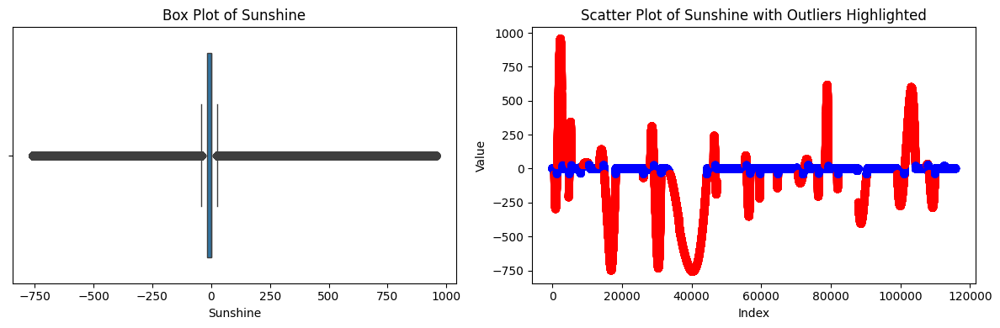

...

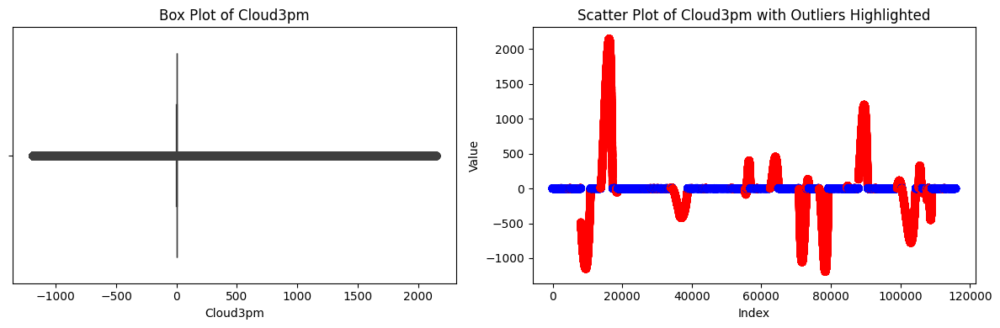

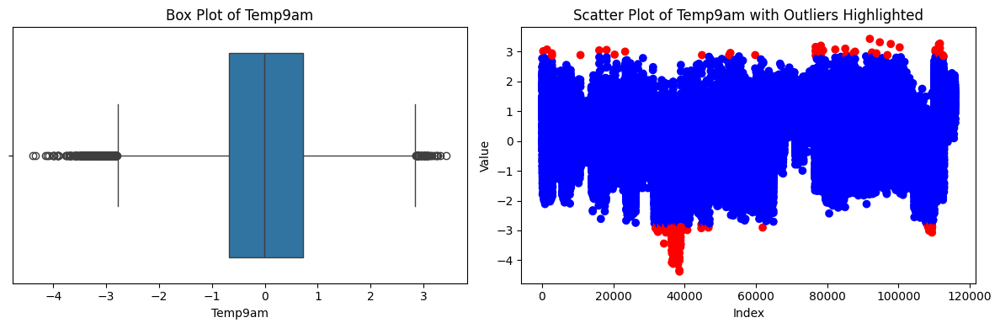

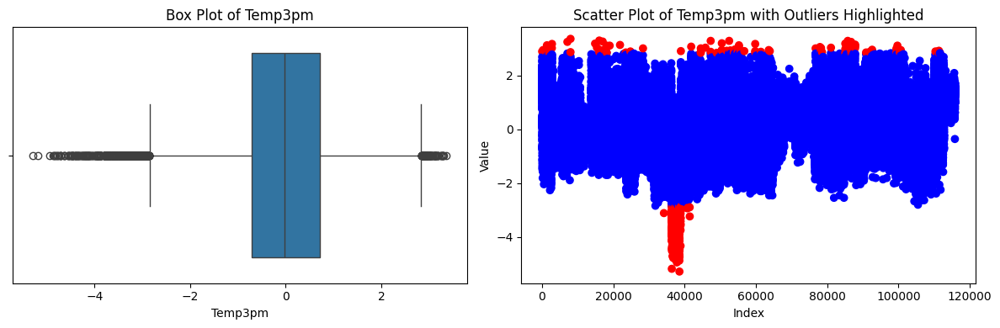

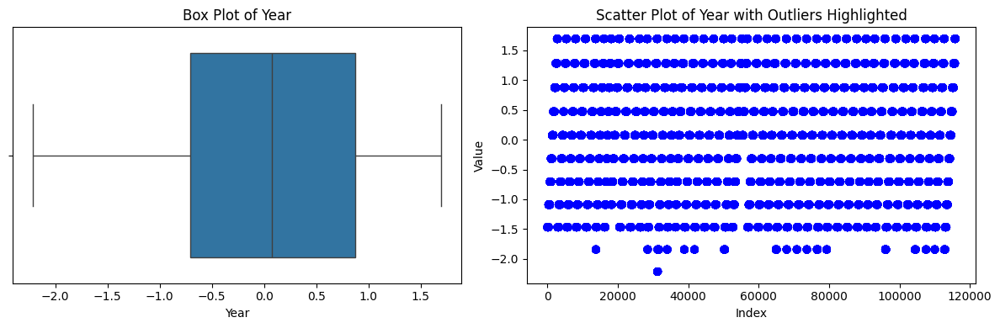

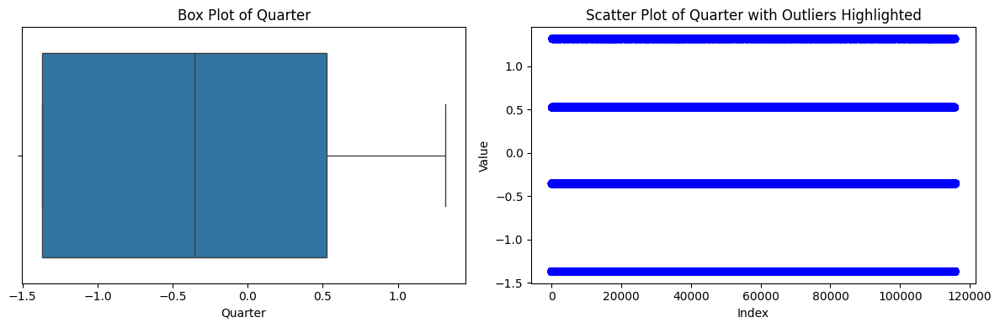

In [27]:
#Plot the Numerical Features Distribution with Outliers.
for col in numerical_columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,4))

    # Box plot for the numerical column
    sns.boxplot(x=df[col], ax=ax1)
    ax1.set_title(f'Box Plot of {col}')
    
    # Scatter plot with outliers highlighted
    ax2.scatter(range(len(df)), df[col], c=['blue' if not x else 'red' for x in outliers[col]])
    ax2.set_title(f'Scatter Plot of {col} with Outliers Highlighted')
    ax2.set_xlabel('Index')
    ax2.set_ylabel('Value')
    plt.tight_layout()
    plt.show()


In [28]:
#Remove the Outliers.
df = df[~outliers.any(axis=1)]

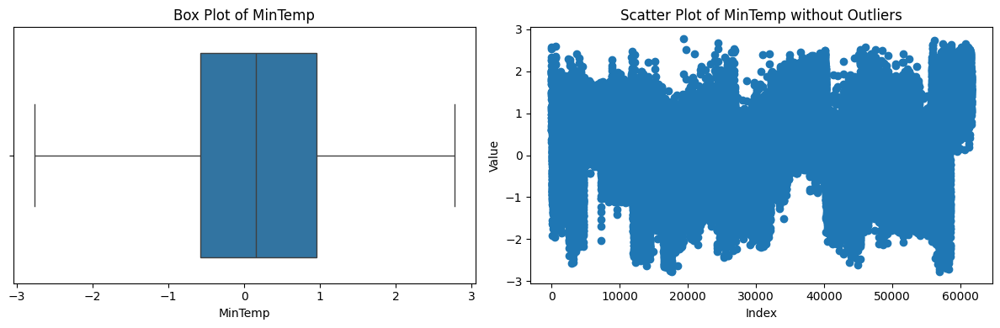

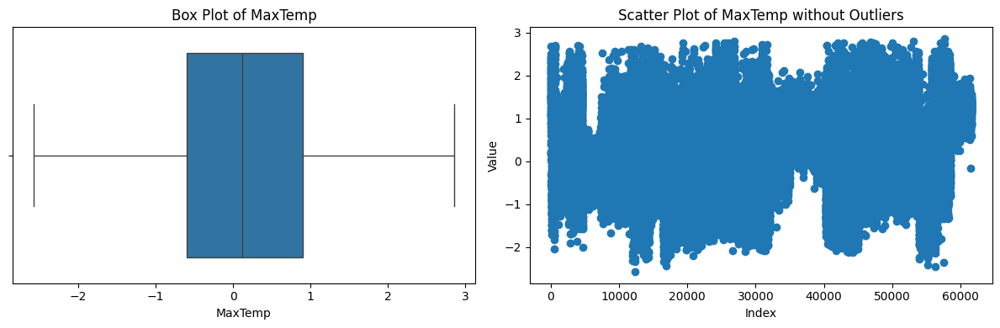

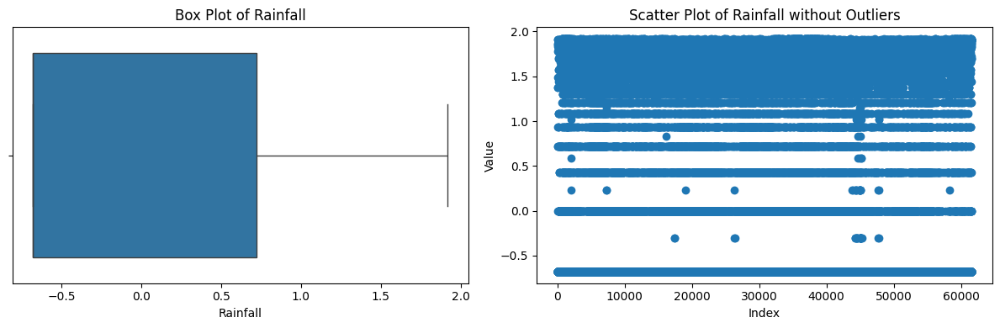

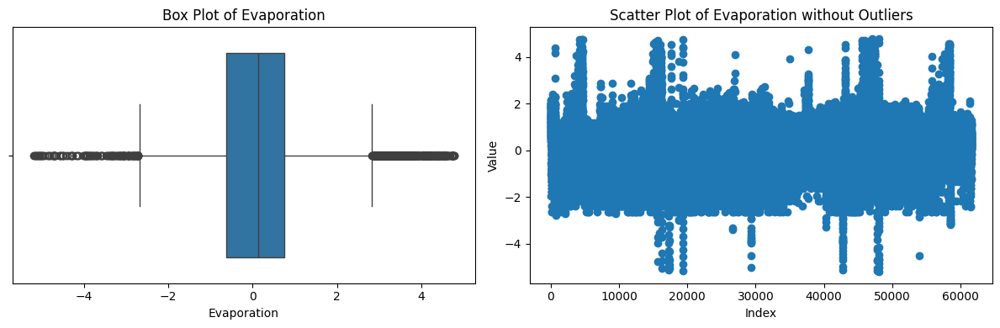

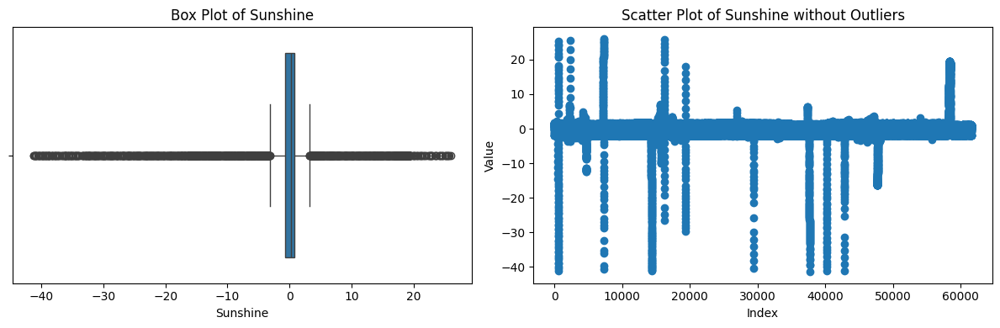

...

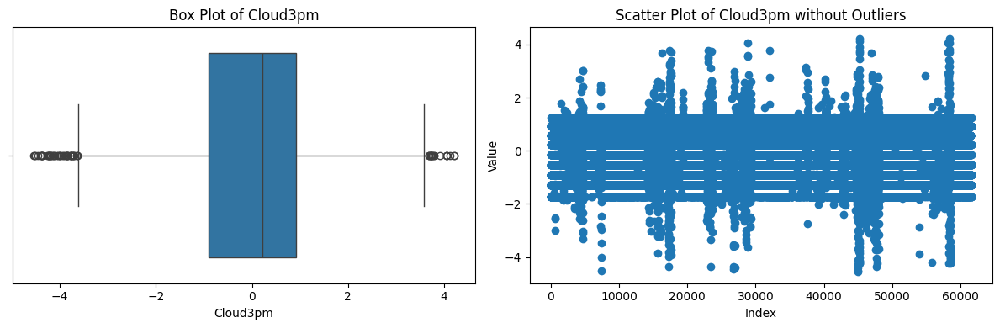

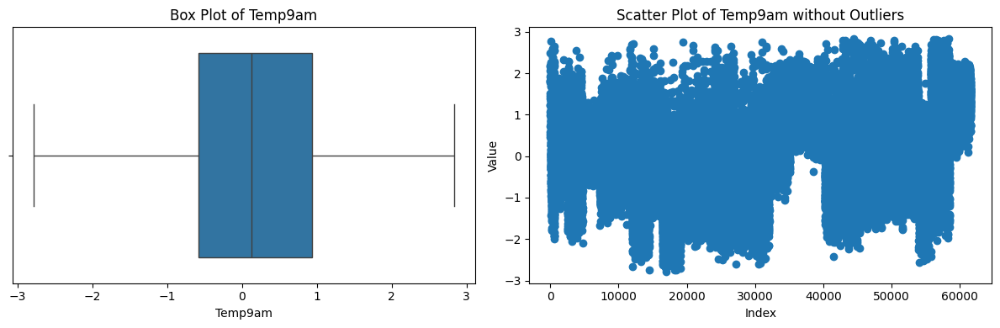

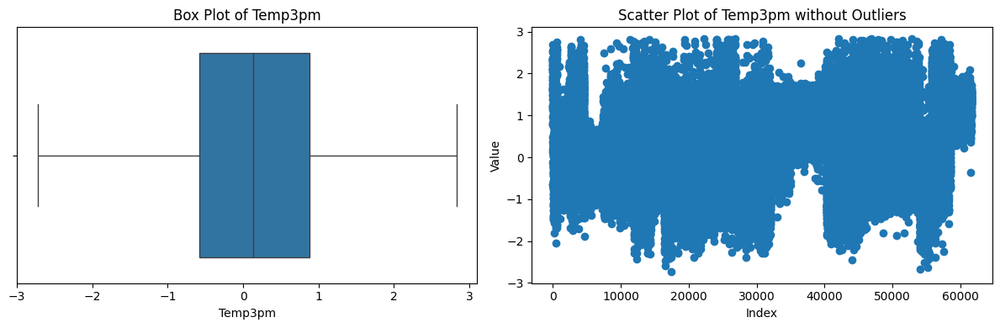

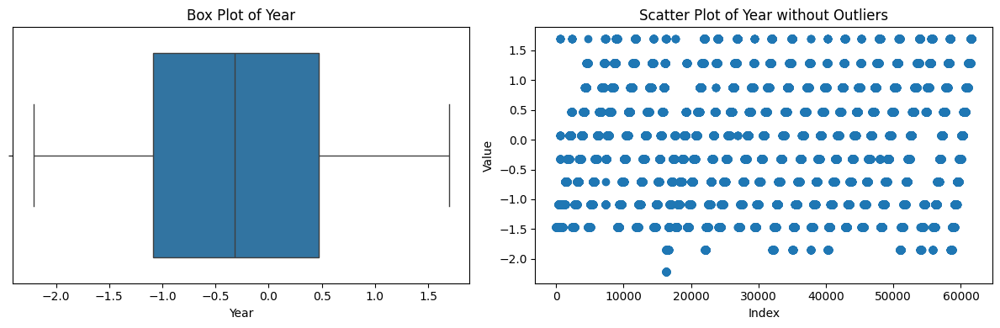

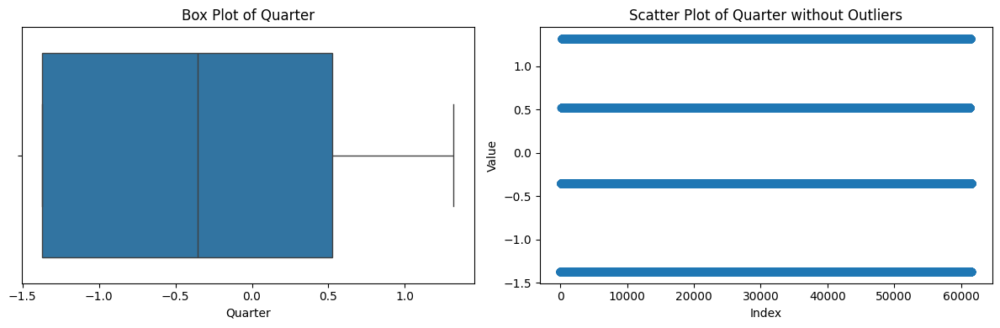

In [29]:
#Plot the Numerical Features Distribution without Outliers.
for col in numerical_columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,4))

    # Box plot for the numerical column
    sns.boxplot(x=df[col], ax=ax1)
    ax1.set_title(f'Box Plot of {col}')
    
    # Scatter plot with outliers highlighted
    ax2.scatter(range(len(df)), df[col])
    ax2.set_title(f'Scatter Plot of {col} without Outliers')
    ax2.set_xlabel('Index')
    ax2.set_ylabel('Value')
    plt.tight_layout()
    plt.show()


In [30]:
#Encode the Categorical Features.
cat_cols = ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'Month', 'Day']
df_encode = pd.get_dummies(df[cat_cols],drop_first=True)

In [31]:
#Concatenate the Encoded Categorical Features with the Numerical Features.
df = pd.concat([df.drop(columns=cat_cols),df_encode],axis=1)

In [32]:
df['RainTomorrow'] = df['RainTomorrow'].map({'No':0,'Yes':1})

# <b><b> Model

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score,accuracy_score,classification_report,confusion_matrix
from sklearn.model_selection import StratifiedKFold, cross_val_score
import xgboost as xg

In [34]:
X = df.drop(columns=['RainTomorrow'],axis=1)
y = df[['RainTomorrow']]

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.3,random_state=42)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(43120, 118) (18480, 118) (43120, 1) (18480, 1)


In [36]:
#Here I use solver = 'saga' because it is more efficient in large datasets.
LogisticRegn = LogisticRegression(solver='saga')

In [37]:
LogisticRegn.fit(X_train,y_train)

LogisticRegression(solver='saga')

In [38]:
Predict = LogisticRegn.predict(X_test)
Predict

array([1, 0, 0, ..., 0, 1, 0])

In [39]:
# Get predicted probabilities (for binary classification, get probabilities for class 1)
y_pred_prob = LogisticRegn.predict_proba(X_test)[:, 1]
y_pred_prob

array([0.71705866, 0.16140434, 0.24352218, ..., 0.06220161, 0.75433612,
       0.00778407])

In [40]:
acuuracy = accuracy_score(y_test,Predict)
print(f'LogisticRegression accoracy: {acuuracy:.4f}')

LogisticRegression accoracy: 0.8595


In [41]:
#Check overfitting or underfitting.
test_performance = LogisticRegn.score(X_test,y_test)
print(f'test data performance: {test_performance:.4f}')

train_performance = LogisticRegn.score(X_train,y_train)
print(f'train data performance: {train_performance:.4f}')
print(f'Test performance - Train performance = {test_performance-train_performance:.4f}')

test data performance: 0.8595
train data performance: 0.8623
Test performance - Train performance = -0.0028


<b><b>Comment:
* Here 0.0027 less performance in test data. So I assume that it's a little bit overfitting problem.

In [42]:
#K-fold Cross Validation to avoid overfitting.
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)
cv_scores = cross_val_score(LogisticRegn, X, y, cv=kf, scoring='accuracy')
print(f'Mean Accuracy: {np.mean(cv_scores):.4f}')
print(f'Standard Deviation: {np.std(cv_scores):.4f}')

Mean Accuracy: 0.8605
Standard Deviation: 0.0039


# <b><b> Confusion Matrix

<img src="Conf.png" alt="Roc Curve" width="800" height="450">

In [43]:
confmat = confusion_matrix(y_test,Predict)

True Positive: 13786, False Positive: 707
False Negative: 1889, True Negative: 2098


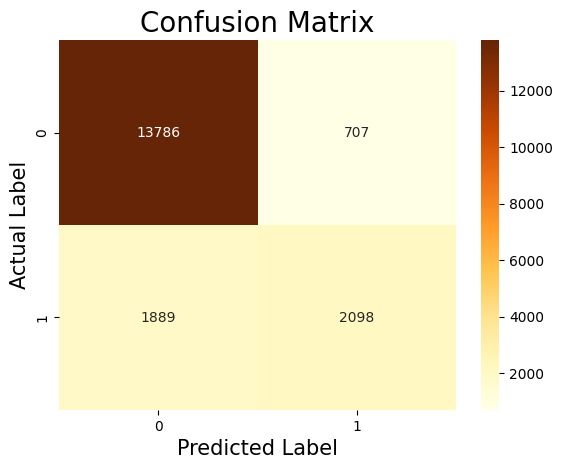

In [44]:
print(f'True Positive: {confmat[0,0]}',f'False Positive: {confmat[0,1]}',sep=', ')
print(f'False Negative: {confmat[1,0]}',f'True Negative: {confmat[1,1]}',sep=', ')

sns.heatmap(confmat, annot=True, fmt='d',cmap="YlOrBr")
plt.xlabel('Predicted Label',fontdict={'size':15})
plt.ylabel('Actual Label',fontdict={'size':15})
plt.title('Confusion Matrix',fontdict={'size':20})
plt.show()

<b><b>Comments:
* `True Positive` is 13787, those actual observation is positive and also predicted to be positive.

* `False Negative` is 1889, those actual observation is positive but predicted to be negative.

* `True Negative` is 2098, those actual observation is negative and also predicted to be negative.

* `False Positive` is 706, those actual observation is negative but predicted to be positive.

# <b><b>Classification metrics

<img src="classifi.png" alt="alt text" width="800" height="400">

**Classification Accuracy:**
* Accuracy is used to measure the performance of the model. It is the ratio of Total correct instances to the total instances.

**Precision:**

* **Precision** is the ratio of True Positives to all the positives predicted by the model.
* **Low precision:** the more False positives the model predicts, the lower the precision.

* **Interpretation**: A high precision indicates that the model is good at avoiding false positives (incorrectly classifying negative instances as positive)

**Recall:**

* **Recall (Sensitivity)** is the ratio of True Positives to all the positives in your Dataset.

* **Low recall:** the more False Negatives the model predicts, the lower the recall.

* **Interpretation**: A high recall indicates that the model is good at capturing most of the positive instances (avoiding false negatives, where positive instances are missed).

In [45]:
Precition = confmat[0,0]/(confmat[0,0]+confmat[0,1])
print(f'Precision: {Precition:.2f}')
Recall = confmat[0,0]/(confmat[0,0]+confmat[1,0])
print(f'Recall: {Recall:.2f}')
Classification_Acuracy = (confmat[0,0]+confmat[1,1])/(confmat[0,0]+confmat[0,1]+confmat[1,0]+confmat[1,1])
print(f'Classification Accuracy: {Classification_Acuracy:.2f}')
F1_Score = (2*Precition*Recall)/(Precition+Recall)
print(f'F1 Score: {F1_Score:.2f}')

Precision: 0.95
Recall: 0.88
Classification Accuracy: 0.86
F1 Score: 0.91


<b><b>Comments:
* `Precision` is 0.95,which indicates that the model is too good at avoiding False Positive.

* `Recall` is 0.88,which indicates that the model is good at capturing most of the positive instances.

* `Classification accuracy` 0.86 ,that's means the Logistic model perform so well.

* `F1 score` is basically Precision-Recall trade off,higher value indicates good performance of model.Here's 0.91

In [46]:
print(classification_report(y_test,Predict))

              precision    recall  f1-score   support

           0       0.88      0.95      0.91     14493
           1       0.75      0.53      0.62      3987

    accuracy                           0.86     18480
   macro avg       0.81      0.74      0.77     18480
weighted avg       0.85      0.86      0.85     18480



# Receiver Operating Characteristic Curve: (Roc Curve)

* It plots the false positive rate (x-axis) against the true positive rate (y-axis).
* True Positive Rate = TP / (TP + FN)
* False Positive Rate = FP / (FP + TN)
* we can assess the performance of the model by the area under the ROC curve (AUC). As a rule of thumb, 0.9–1=excellent; 0.8-.09=good; 0.7–0.8=fair; 0.6–0.7=poor; 0.50–0.6=fail.

Confusion matrix and Classification metrics theory Reference: https://www.kdnuggets.com/2020/04/performance-evaluation-metrics-classification.html & Gemini AI.

<img src="roc.png" alt="Roc Curve" width="800" height="600">



Image Source:https://en.wikipedia.org/wiki/Receiver_operating_characteristic#/media/File:Roc_curve.svg

In [47]:
True_Positive_Rate = confmat[0,0]/(confmat[0,0]+confmat[1,0])
print(f'True Positive Rate: {True_Positive_Rate:.2f}')

True Positive Rate: 0.88


<b><b>Comment:
* True Positive rate indicates that the rate of Actual value is positive and also predicted to be positive. Higher rate means the model is too good at avoiding False Positive.

In [48]:
False_Positive_Rate = confmat[0,1]/(confmat[0,1]+confmat[1,1])
print(f'False Positive Rate: {False_Positive_Rate:.2f}')

False Positive Rate: 0.25


<b><b>Comment:
* False Positive rate indicates that the rate of Actual value is positive but predicted to be nrgative.Lower rate means the model is accurately predict actual value is positive and also predicted to be Positive.Mention that a higher value of FPR is alarming . Here's 0.25, so we may say that a little alarming for the model performance but it's can be ignored.


In [49]:
# Calculate FPR, TPR, and thresholds
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

#Plot the ROC curve.
import plotly.graph_objects as go
fig = go.Figure()

# Add the ROC curve trace (FPR vs TPR)
fig.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines+markers', name='ROC curve', 
                         line=dict(color='blue'), marker=dict(size=8)))

# Add the diagonal line (random classifier)
fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random Classifier', 
                         line=dict(color='red', dash='dash')))

fig.update_layout(width=1000,height=650,
    title=dict(text='ROC Curve.', font=dict(size=30)),
    xaxis_title=dict(text='False Positive Rate', font=dict(size=25)),
    yaxis_title=dict(text='True Positive Rate', font=dict(size=25)),
    legend=dict(font=dict(size=15)))

fig.show()

In [50]:
print(roc_auc_score(y_test, y_pred_prob).__format__('.2f'))

0.88


<b><b>Comments:
* The Roc curve is close to top left corner which indicates model is accurately classified the target feature.
* roc_auc_score is a number, the higher value indicates the good peformance of classifier. Here's 0.88,so conclude that the Logistic model is good at this classification problem.

# <b><b>Report

<b><b>
* The main model accuracy is 0.8596, after Kfold cross validation it's 8605. A little bit improvement in model performance. Finally said that the Logistic model is doing better to predict tomorrow will rain in Australia yes or not.

Comment inspiration: https://www.kaggle.com/code/prashant111/logistic-regression-classifier-tutorial